# Torettome Meta-ICA Internetwork correlation Analysis... 
####### inspired be Biswal_PNAS_2010 and Cerliani_JAMAPsych_2015 papers


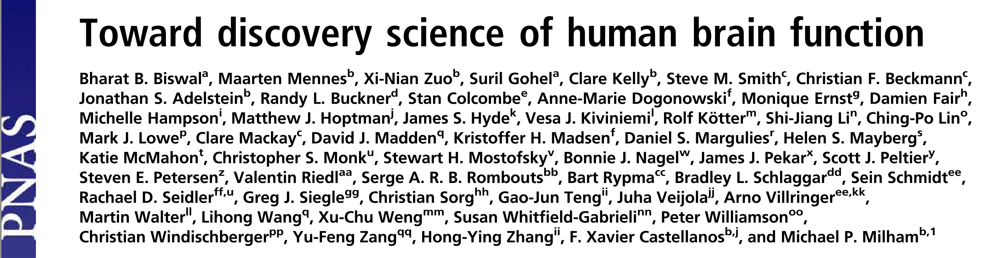

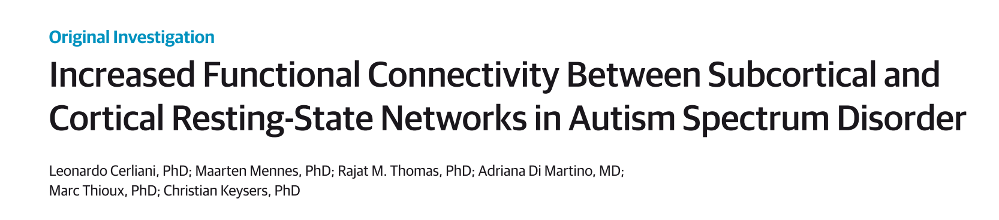

In [1]:
from IPython.display import Image, display
display(Image('/Users/kanaan/Desktop/biswal.png'))
display(Image('/Users/kanaan/Desktop/cerliani.png'))

In [2]:
%matplotlib inline
import os 
import numpy as np 
import nibabel as nb 
import matplotlib.pyplot as plt 
import json
import pandas as pd 
import math
from scipy import stats 
import seaborn as sns 
from nilearn.image import iter_img, index_img
from nilearn.plotting import plot_stat_map, show, plot_prob_atlas, find_xyz_cut_coords, plot_surf_stat_map, plot_surf,show
from nilearn import datasets

from kanaan_surf import plot_surf_stat_all

import warnings
warnings.filterwarnings('ignore')

sns.set_style('white')
pd.options.display.max_rows=999
fs5 = datasets.fetch_surf_fsaverage5()

data_dir  = '/scr/malta4/workspace/project_TOURETTOME/'
data_dir  = '/Users/kanaan/SCR/workspace/TOURETTOME_RSN'

pheno_dir  = os.path.join(data_dir, 'phenotypic')
pproc_dir  = os.path.join(data_dir, 'preproc')
meta_dir   = os.path.join(pproc_dir,'META_ICA','ICA_merged')

reg_header = '/afs/cbs.mpg.de/software/freesurfer/6.0.0/ubuntu-xenial-amd64/average/mni152.register.dat'
reg_header= '/Users/kanaan/SCR/Software/freesurfer/average/mni152.register.dat'


outliers = ["LZ004", "LZ017", "LZ018", "LZ025", "LZ027", "LZ029", "LZ038", "LZ061", "PA009", "PA058", "HA009",
            "LZ001", "LZ052", "LZ052", "LZ052", "HA053"]

# Get phenotypic data

In [3]:
lz = pd.read_csv(os.path.join(pheno_dir, 'phenotypic_leipzig.csv'),index_col=0)
pa = pd.read_csv(os.path.join(pheno_dir, 'phenotypic_paris.csv'),index_col=0)
ha = pd.read_csv(os.path.join(pheno_dir, 'phenotypic_hannover_a.csv'),index_col=0)

drop_cols = ['NCoils', 'Sequence', 'Resolution', 'TR', 'TE', 'FlipAngle', 'ScanDate', 'Scanner', 'NVols']
pheno = pd.concat([lz,pa,ha]).drop(drop_cols, axis=1)
    
# Get FD_mean
df_fd = pd.DataFrame(index=pheno.index, columns=['FD'])
for subject in pheno.index:
    fd1d= os.path.join(pproc_dir, 'FD', '%s_FD196.1D'%subject)
    if os.path.isfile(fd1d):
        fd_mu = np.mean(np.genfromtxt(fd1d))
        df_fd.loc['%s'%subject]['FD'] = fd_mu

# Get Dual Regression subject ID
population_dict  = json.load(open(os.path.join(pproc_dir, 'META_ICA/DUAL_REGRESSION/dualreg_subject_list.json')))
population_dict  = {v: k for k, v in population_dict.iteritems()}
df_id            = pd.DataFrame(index=pheno.index, columns=['DR_ID'])
for subject in pheno.index:
    if subject in population_dict.keys():
        df_id.loc['%s'%subject]['DR_ID'] = '%5d'%int(population_dict[subject])
    
df = pd.concat([pheno,df_fd, df_id],axis = 1).drop(outliers, axis = 0)


patients = [subject for subject in df.index if df.loc['%s'%subject]['Group'] == 'patients']
controls = [subject for subject in df.index if df.loc['%s'%subject]['Group'] == 'controls']
print 'Number of Patients =', len(patients)
print 'Number of Controls =', len(controls)

Number of Patients = 121
Number of Controls = 87


In [4]:
df.head()

,Name,Site,Group,Age,Sex,FD,DR_ID
LZ002,BATP,Leipzig,patients,22,male,0.114487,0
LZ003,BE9P,Leipzig,patients,18,male,0.081778,1
LZ005,CF1P,Leipzig,patients,28,male,0.0494699,3
LZ006,CM5P,Leipzig,patients,27,male,0.232461,4
LZ007,DF2P,Leipzig,patients,56,male,0.181006,5


# Visualize all components

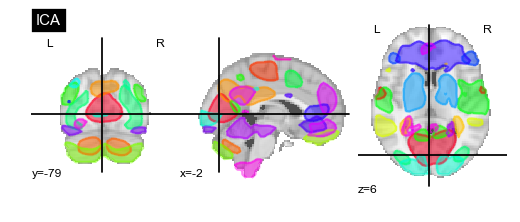

In [5]:
components_img = os.path.join(meta_dir, 'melodic_IC.nii.gz')
plot_prob_atlas(components_img, view_type="filled_contours",title="ICA", cut_coords= (-2, -79, 6))


In [6]:
def map_to_surf(components_img, component_id, hemi, datadir, regheader= reg_header):
    
    fname = os.path.join(meta_dir,'component_%s_%s.mgh'%(i,hemi))
    if not os.path.isfile(fname):
        print 'IC #',i, hemi

        #load 3d component from 4D
        component_img = index_img(components_img, component_id)

        # save component as file
        component = os.path.join(datadir, 'component_%s.nii.gz'%i)
        index_img(components_img, i).to_filename(component)

        # map to surface

        os.system('mri_vol2surf '
                  '--mov %s --reg %s --projfrac-avg 0.2 0.8 0.2 '
                  '--trgsubject fsaverage5 --interp nearest --hemi %s --out %s'
                  %(component,reg_header, hemi, fname))
    data =  nb.load(fname).get_data().reshape(10242,)
    return data

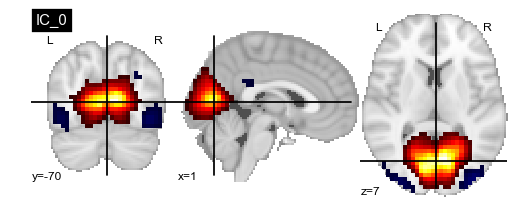

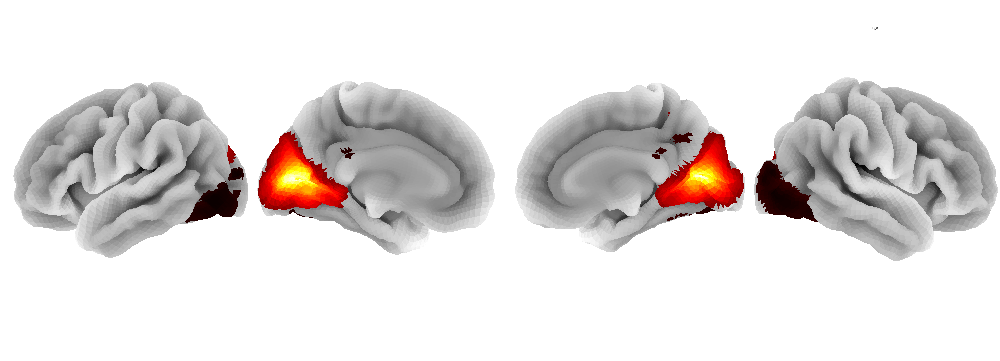

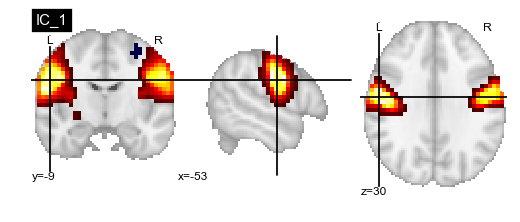

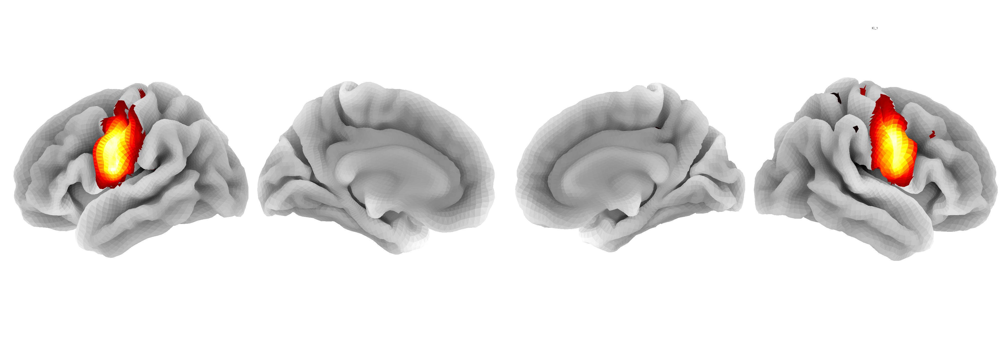

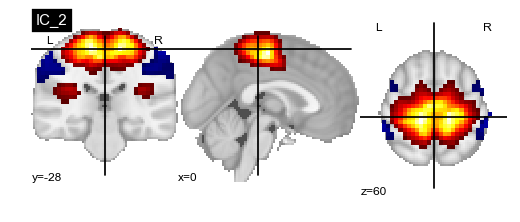

...

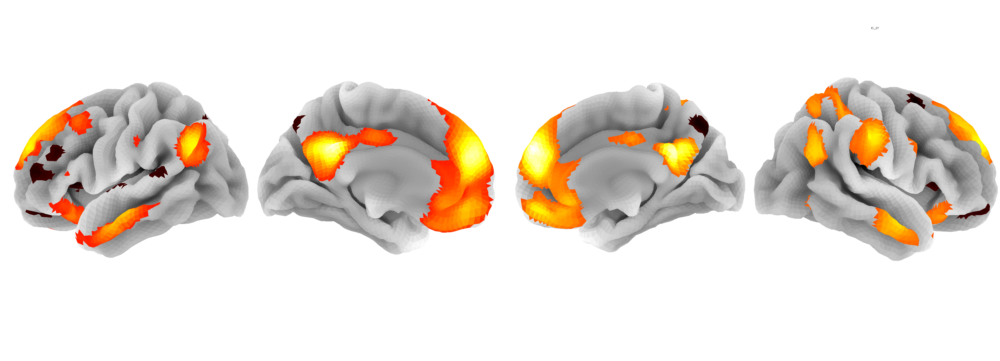

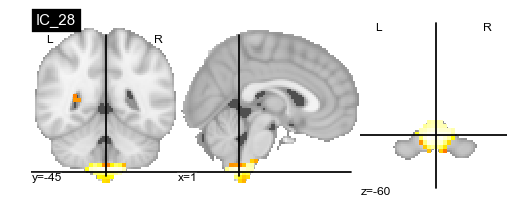

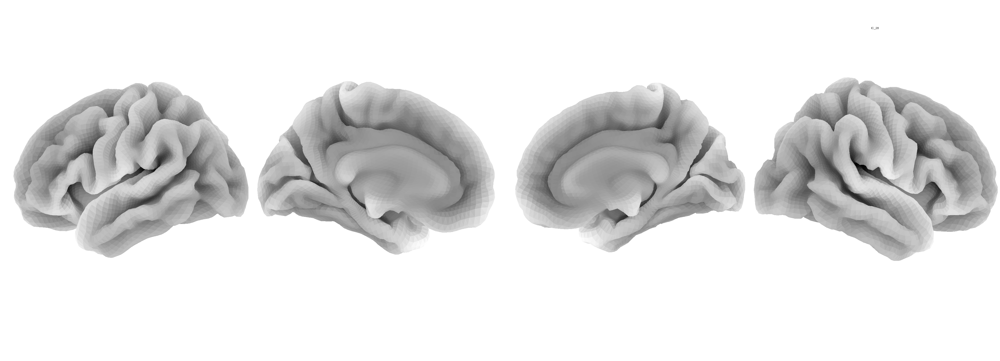

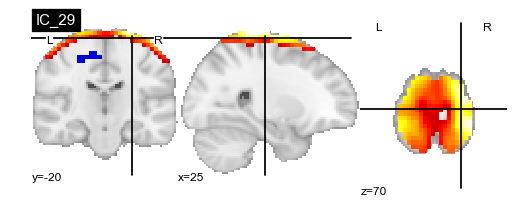

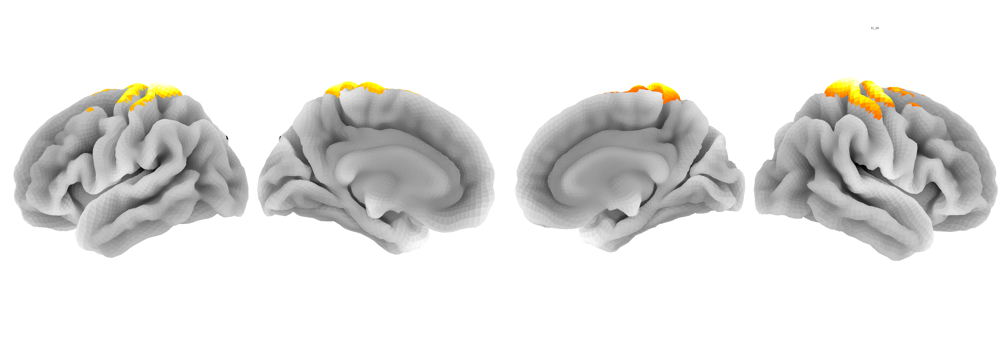

In [7]:
for i in xrange(30):
    lh = map_to_surf(components_img, i, 'lh', meta_dir, regheader= reg_header)
    rh = map_to_surf(components_img, i, 'rh', meta_dir, regheader= reg_header)
    plot_stat_map(index_img(components_img, i), threshold = 3, colorbar=False, display_mode= 'ortho',title='IC_%d'%i)
    plot_surf_stat_all(fs5,lh,rh, threshold = 3,alpha = 1, cmap = 'hot',output_file = None, title='IC_%d'%i)

# Define RSN networks 

In [8]:
dict_components  = {0:'V1', 1:'SMN_1', 2: 'SMN_2', 3:'CB_ant', 4:'DMN_1', 5:'noise', 6:'FPN_R', 7:'SN', 8:'Noise', 
                   9:'Noise', 10:'Temporal', 11:'DMN_2', 12: 'Auditory', 13:'Premotor', 14:'V2', 15:'DAN', 16:'V3',
                   17:'FPN_R', 18:'SMN3', 19:'BG', 20:'noise', 21:'FPN_x', 22:'attentional', 23:'DMN_3', 24:'noise', 
                   25:'noise', 26:'noise', 27:'DMN_4', 28:'noise', 29:'noise'}

### Lets compare to the Smith_2009 components first 

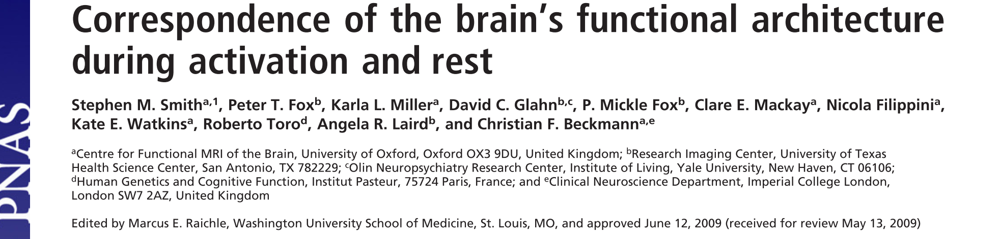

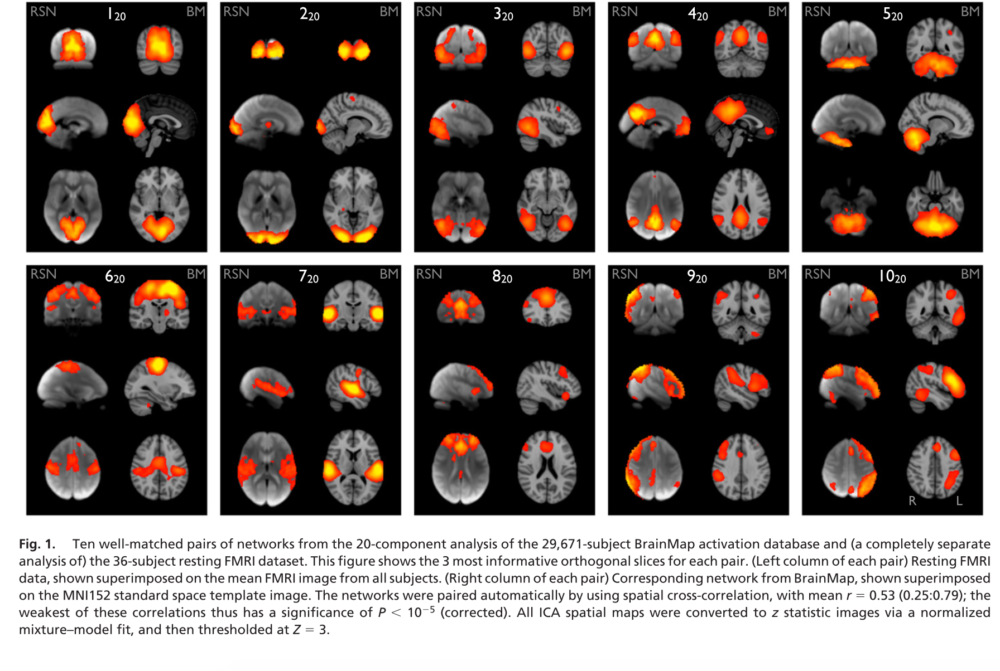

In [9]:
smith_10 = os.path.join(meta_dir, 'PNAS_Smith09_rsn10.nii.gz')
smith_20 = os.path.join(meta_dir, 'PNAS_Smith09_rsn20.nii.gz')
display(Image('/Users/kanaan/Desktop/smith.png'))
display(Image(filename= os.path.join(pproc_dir, 'smith_pnas2009_rsn10.png')) )

## Cross correlation between meta_ica_compoentns and smith_rsn20


In [10]:
# Choose matches from here 
os.chdir(meta_dir)
os.system('fslcc -t 0.4 melodic_IC.nii.gz PNAS_Smith09_rsn20_4mm.nii.gz > fsl_cc.txt')

0

In [11]:
arr = np.genfromtxt(os.path.join(meta_dir, 'fsl_cc.txt'))
df_ic_match = pd.DataFrame(arr, columns=['Meta_IC', 'Smith_IC', 'R_value']).reindex()
df_ic_match

,Meta_IC,Smith_IC,R_value
0,1.0,6.0,0.75
1,3.0,2.0,0.43
2,4.0,9.0,0.40
3,5.0,7.0,0.58
4,6.0,1.0,0.64
5,7.0,13.0,0.67
6,8.0,3.0,0.43
7,8.0,11.0,0.40
8,9.0,14.0,0.47
9,12.0,7.0,0.45


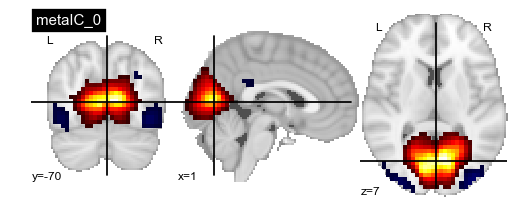

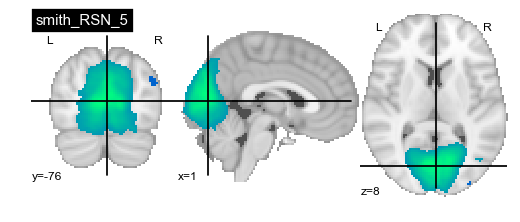

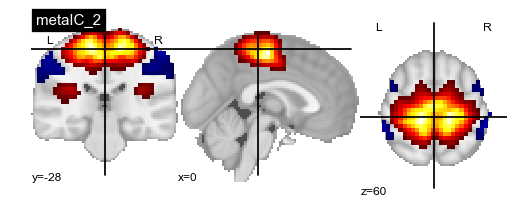

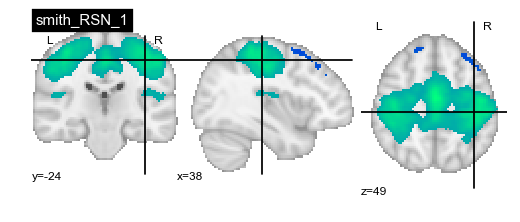

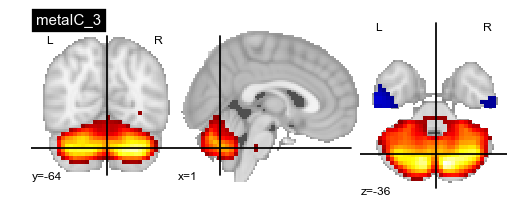

...

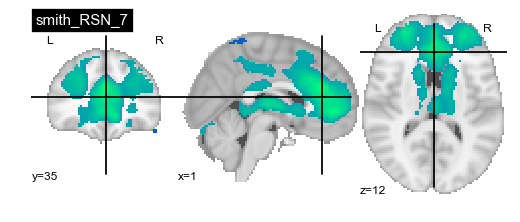

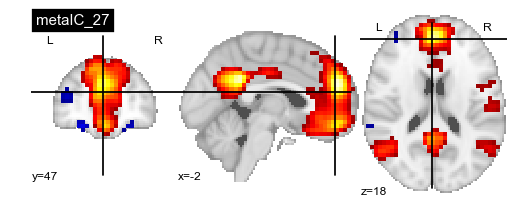

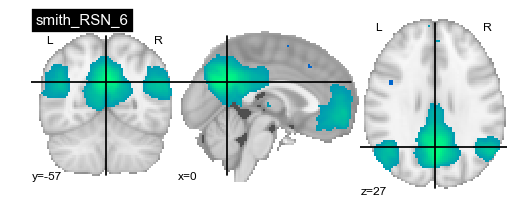

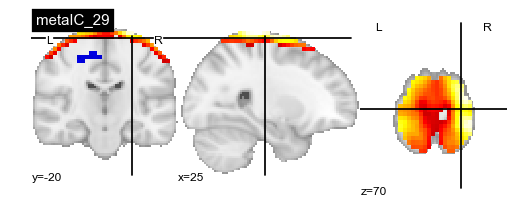

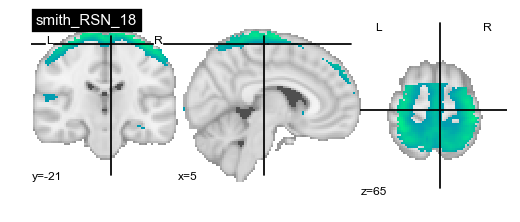

In [12]:
matched_ics = len(df_ic_match.index)
for i in range(0, matched_ics):
    meta_ic  = int(df_ic_match.iloc[i]['Meta_IC'])  -1
    smith_ic = int(df_ic_match.iloc[i]['Smith_IC']) -1
    
    plot_stat_map(index_img(components_img, meta_ic), threshold = 3, colorbar=False, 
                  display_mode= 'ortho',title='metaIC_%i'%meta_ic)
    plot_stat_map(index_img(smith_20, smith_ic), cmap='winter',  threshold = 3, colorbar=False, 
                  display_mode= 'ortho',title='smith_RSN_%s'%smith_ic)
    

In [13]:
RSN_dict  = {0:'Visual_medial', 
         1: 'SensoriMotor_medial',
         2:'SensoriMotor_medial',
         3:'Cerebellar_anterior',
         4:'DefaultMode_posterior',
         #5:'noise_wm',
         6:'FrontoParietal_right',
         7:'Salience',  #mismatch with auditory
         #8:'noise_frontal',
         #9:  # No-Match
         #10: # No-Match
         #11:'', #mismatch with default
         12:'Auditory',
         #13: # No-Match
         14:'Visual_lateral',
         #15: # No-Match
         16:'Visual_medial',
         17:'FrontoParietal_left',
         18:'Somatormotor_lateral',
         #22:'' #mismatch with default
         23:'Executive',
         27:'DefaultMotor_anterior',
         #29:'noise_'
        }

# Extract timeseris of RSNs and compute correlation matrix for each subject 

In [14]:
RSNs = RSN_dict.keys()
Noise = []#[i for i in range(30) if i not in RSNs]

df['DR_ID'].dropna()

def compute_RSN_correlation(population, Noise):
    corrmat_all =[]
    for subject in population:
        if subject in population_dict.keys():
            idx = population_dict[subject]
            fname   = os.path.join(pproc_dir, 'META_ICA/DUAL_REGRESSION/dr_stage1_subject%05d_bp.nii.gz'%int(idx))
            if os.path.isfile(fname):
                time =  nb.load(fname).get_data()
                df = pd.DataFrame(time.reshape(time.shape[-1],time.shape[-2])).drop(Noise, axis =1)
                corrmat_all.append(df.corr('pearson'))
    return pd.concat(corrmat_all), corrmat_all


In [15]:
corrmat_controls, corrmat_controls_ = compute_RSN_correlation(controls,Noise)
corrmat_patients, corrmat_patients_ = compute_RSN_correlation(patients,Noise)

# Visualize Mean correlation matrix for each group

In [16]:
#compute means
corrmat_controls_mean = corrmat_controls.groupby(corrmat_controls.index).mean()
corrmat_patients_mean = corrmat_patients.groupby(corrmat_patients.index).mean()

#rename columns 
#def rename_cols(df):
#    for x in df.columns:
#        df=df.rename(columns = {x:RSN_dict[x]})
#    for x in df.index:
#        df=df.rename(index={x:RSN_dict[x]})
#    
#    return df 
#corrmat_controls_mean = rename_cols(corrmat_controls_mean)
#corrmat_patients_mean = rename_cols(corrmat_patients_mean)

#compute difference
corrmat_diff          = corrmat_controls_mean - corrmat_patients_mean
print corrmat_controls_mean[0][14]
print corrmat_patients_mean[0][14]

-0.0660240516912
-0.0740428770046


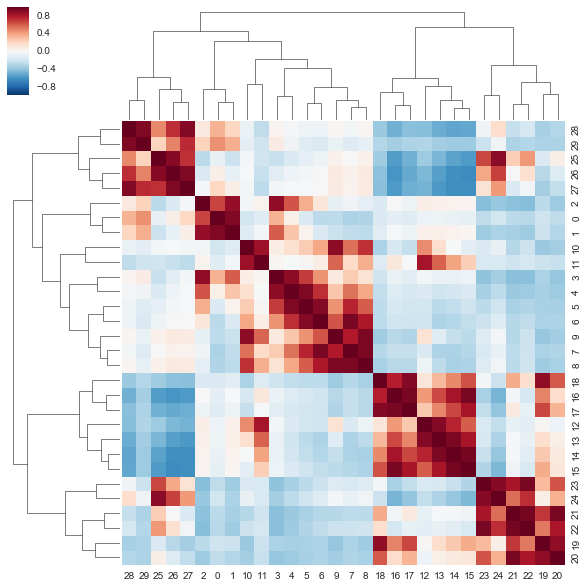

In [17]:
g = sns.clustermap(corrmat_controls_mean, vmin = -1, vmax = 1)
#plt.setp(g.ax_heatmap.get_yticklabels(), rotation=0)


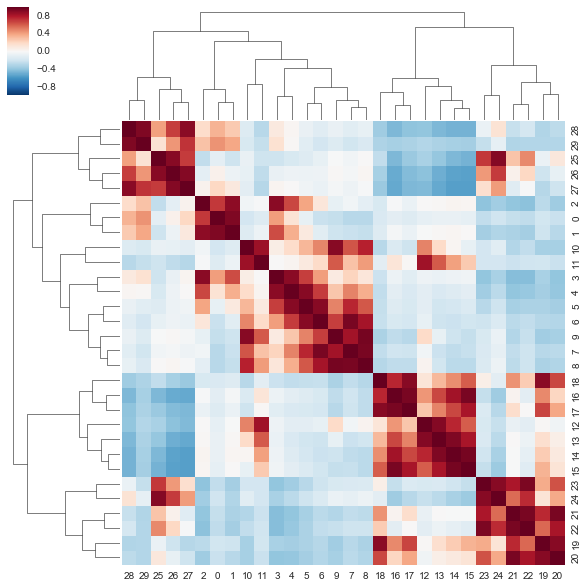

In [18]:
sns.clustermap(corrmat_patients_mean, vmin = -1, vmax = 1, metric = 'correlation',
               row_linkage= g.dendrogram_row.linkage, col_linkage = g.dendrogram_col.linkage)


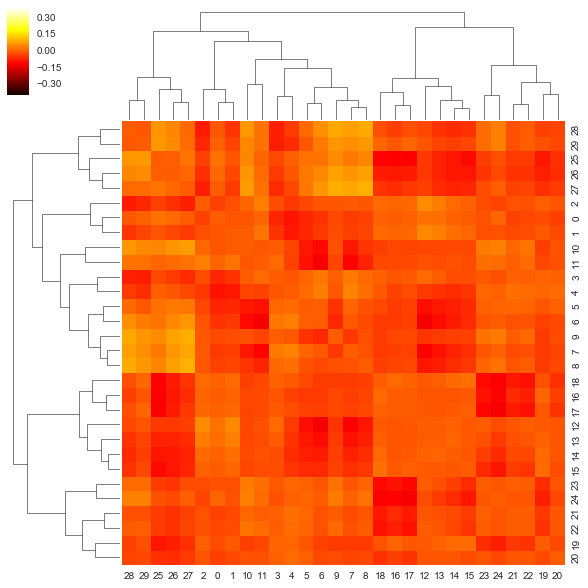

In [19]:
sns.clustermap(corrmat_diff, vmin = -.4, vmax = .4, cmap='hot', metric = 'correlation',
               row_linkage= g.dendrogram_row.linkage, col_linkage = g.dendrogram_col.linkage)

# Run quick t-test for each RSN correlation... 
### #to do: run non-parametric stats with TFCE/FDR multiple comparison correctionu sing FSL_randomise
### #include covariates for (a) Gender (paris data skewed by gender); (b) eyes/open closed (different for paris data), (c) age, (d) motion FD; (e) Site ID; (f) 

In [20]:
rvals_controls = np.asanyarray([np.asarray(MAT) for MAT in corrmat_controls_]).reshape(86,30*30)
rvals_patients = np.asanyarray([np.asarray(MAT) for MAT in corrmat_patients_]).reshape(121,30*30)

In [21]:
P_vals = np.asanyarray([stats.ttest_ind(np.asanyarray(rvals_controls).T[i], np.asanyarray(rvals_patients).T[i])[1] for i in range(30*30)])
P_mat  = P_vals.reshape(30,30)

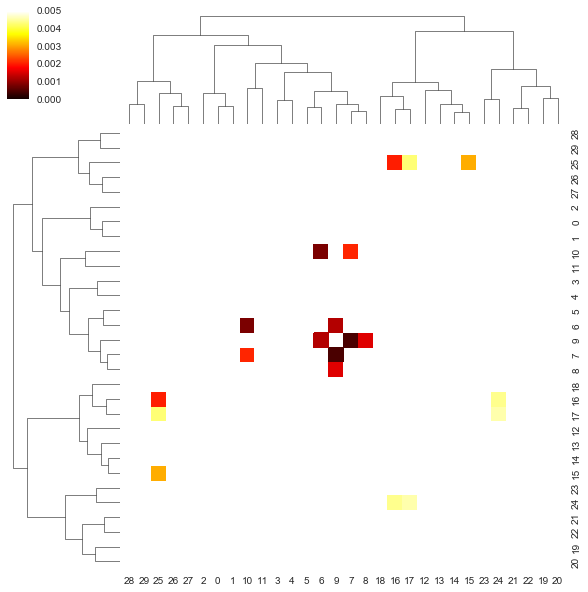

In [22]:
sns.clustermap(P_mat, vmin = 0.0, vmax = 0.005, cmap = 'hot',figsize=(10, 10),
               row_linkage= g.dendrogram_row.linkage, col_linkage = g.dendrogram_col.linkage)